<a href="https://colab.research.google.com/github/tejasvi541/Machine-Learning/blob/main/CreactiveAI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random
import os
from PIL import Image

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive/Colab Notebooks/CreativeAI

/content/drive/MyDrive/Colab Notebooks/CreativeAI


In [ ]:
# Load trained inceptionNet model, for more information on Transfer Learning, check previous case studies
base_model = tf.keras.applications.InceptionV3(include_top = False, weights = 'imagenet')

87916544/87910968 [==============================] - 1s 0us/step


In [ ]:
%ls

eiffel.jpg  mars_eiffel.avi  mars_eiffel.zip  mars.jpg


In [ ]:
base_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
_______________________________________________________________________________________

In [ ]:
img_1 = Image.open("./mars.jpg")

img_2 = Image.open("./eiffel.jpg")

# Blend the images
image = Image.blend(img_1, img_2, 0.5) # The interpolation alpha factor, if alpha is 0.0, a copy of the first image is returned.
# If alpha is 1.0, a copy of the second image is returned

# Image save
image.save("img_0.jpg")

In [ ]:
sampleimg = tf.keras.preprocessing.image.load_img("img_0.jpg")

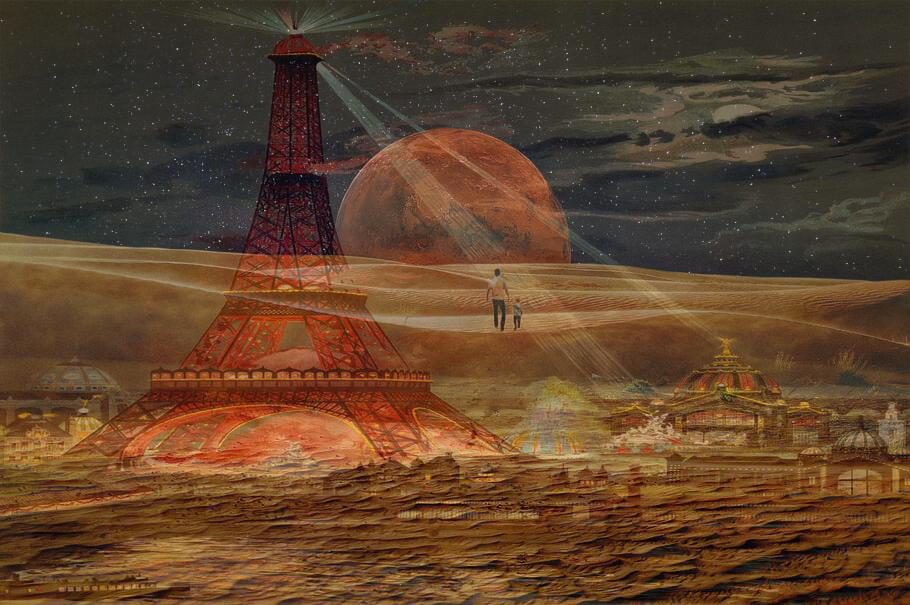

In [ ]:
sampleimg

In [ ]:
np.shape(sampleimg)

(605, 910, 3)

In [ ]:
# Convert to numpy array
Sample_Image = tf.keras.preprocessing.image.img_to_array(sampleimg)

# Sample_Image = np.array(Sample_Image)

# Confirm that the image is converted to Numpy array
print(type(Sample_Image))

# Obtain the max and min values
print('min pixel values = {}, max pixel values = {}'.format(Sample_Image.min(), Sample_Image.max()))

# Normalize the input image
Sample_Image = np.array(Sample_Image)/255.0
print(Sample_Image.shape)

# Let's verify normalized images values!
print('min pixel values = {}, max pixel values = {}'.format(Sample_Image.min(), Sample_Image.max()))
Sample_Image = tf.expand_dims(Sample_Image, axis = 0)

<class 'numpy.ndarray'>
min pixel values = 0.0, max pixel values = 255.0
(605, 910, 3)
min pixel values = 0.0, max pixel values = 1.0


## Training Model

In [ ]:
# Maximize the activations of these layers

names = ['mixed3', 'mixed5', 'mixed7']

layers = [base_model.get_layer(name).output for name in names]

# create the feature extraction model
deepdream_model = tf.keras.Model(inputs = base_model.input, outputs = layers)

In [ ]:
deepdream_model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
______________________________________________________________________________________________

In [ ]:
activations = deepdream_model(Sample_Image)

activations

[<tf.Tensor: shape=(1, 36, 55, 768), dtype=float32, numpy=
 array([[[[0.        , 0.        , 0.        , ..., 0.02111739,
           0.42713785, 0.30679742],
          [0.        , 0.13667153, 0.        , ..., 0.        ,
           0.        , 0.        ],
          [0.        , 0.25661832, 0.        , ..., 0.        ,
           0.07347696, 0.        ],
          ...,
          [0.        , 0.        , 0.        , ..., 0.        ,
           0.        , 0.        ],
          [0.        , 0.        , 0.        , ..., 0.42646617,
           0.        , 0.        ],
          [0.05945809, 0.        , 0.        , ..., 0.42646617,
           0.6412622 , 0.        ]],
 
         [[0.6751412 , 0.        , 0.        , ..., 0.02111739,
           0.28741294, 0.65448624],
          [0.        , 0.        , 0.        , ..., 0.        ,
           0.        , 0.22241248],
          [0.        , 0.        , 0.        , ..., 0.        ,
           0.        , 0.        ],
          ...,
        

In [ ]:
len(activations)

3

## Task Understand how to perform gradient calculation and tf.gradienttape()

-> tf.GradientTape() is used to record opertions for automatice differntiation

-> for example, let us assume we have the following functions y =x^3. 

-> The gradient at x= 2 can be computed as follows : dy/dx = 3 * x^2 = 12

In [ ]:
x = tf.constant(2.0)

In [ ]:
with tf.GradientTape() as g:
  g.watch(x)
  y = x *x *x
  dy_dx = g.gradient(y, x)

dy_dx

<tf.Tensor: shape=(), dtype=float32, numpy=12.0>

## Applying Deep Dream

In [ ]:
Sample_Image.shape

TensorShape([1, 605, 910, 3])

In [ ]:
Sample_Image = tf.squeeze(Sample_Image, axis =0)

In [ ]:
# Fucntion used for loss calculation
def calc_loss(image, model):
  # It works by feedforwarding the input image through the network and generate activations
  # Then obtain the average and sum of those outputs

  img_batch = tf.expand_dims(image, axis=0)
  layer_activations = model(img_batch)

  print('ACTIVATION VALUES (LAYER OUTPUT) =\n', layer_activations)

  losses = []

  for act in layer_activations:
    loss = tf.math.reduce_mean(act) # Calculate mean of each activation
    losses.append(loss)

  print('LOSSES (FROM MULTIPLE ACTIVATION LAYERS) = ', losses)
  print('LOSSES SHAPE (FROM MULTIPLE ACTIVATION LAYERS) = ', np.shape(losses))
  print('SUM OF ALL LOSSES (FROM ALL SELECTED LAYERS)= ', tf.reduce_sum(losses))

  return  tf.reduce_sum(losses) # Calculate sum 

In [ ]:
loss = calc_loss(tf.Variable(Sample_Image), deepdream_model)

ACTIVATION VALUES (LAYER OUTPUT) =
 [<tf.Tensor: shape=(1, 36, 55, 768), dtype=float32, numpy=
array([[[[0.        , 0.        , 0.        , ..., 0.02111739,
          0.42713785, 0.30679742],
         [0.        , 0.13667153, 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.25661832, 0.        , ..., 0.        ,
          0.07347696, 0.        ],
         ...,
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.42646617,
          0.        , 0.        ],
         [0.05945809, 0.        , 0.        , ..., 0.42646617,
          0.6412622 , 0.        ]],

        [[0.6751412 , 0.        , 0.        , ..., 0.02111739,
          0.28741294, 0.65448624],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.22241248],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
       

In [ ]:
loss

<tf.Tensor: shape=(), dtype=float32, numpy=0.5577076>

## Gradient calc

In [ ]:
# When you annotate a function with tf.function, the function can be called like any other python defined function. 
# The benefit is that it will be compiled into a graph so it will be much faster and could be executed over TPU/GPU

@tf.function
def deepdream(model, image, step_size):
    with tf.GradientTape() as tape:
      # This needs gradients relative to `img`
      # `GradientTape` only watches `tf.Variable`s by default
      tape.watch(image)
      loss = calc_loss(image, model) # call the function that calculate the loss 

    # Calculate the gradient of the loss with respect to the pixels of the input image.
    # The syntax is as follows: dy_dx = g.gradient(y, x) 
    gradients = tape.gradient(loss, image)

    print('GRADIENTS =\n', gradients)
    print('GRADIENTS SHAPE =\n', np.shape(gradients))

    # tf.math.reduce_std computes the standard deviation of elements across dimensions of a tensor
    gradients /= tf.math.reduce_std(gradients)  

    # In gradient ascent, the "loss" is maximized so that the input image increasingly "excites" the layers.
    # You can update the image by directly adding the gradients (because they're the same shape!)
    image = image + gradients * step_size
    image = tf.clip_by_value(image, -1, 1)

    return loss, image

In [ ]:
def run_deep_dream_simple(model, image, steps = 100, step_size = 0.01):
  # Convert from uint8 to the range expected by the model.
  image = tf.keras.applications.inception_v3.preprocess_input(image)

  for step in range(steps):
    loss, image = deepdream(model, image, step_size)
    
    if step % 100 == 0:
      plt.figure(figsize=(12,12))
      plt.imshow(deprocess(image))
      plt.show()
      print ("Step {}, loss {}".format(step, loss))

  # clear_output(wait=True)
  plt.figure(figsize=(12,12))
  plt.imshow(deprocess(image))
  plt.show()

  return deprocess(image)

In [ ]:
def deprocess(image):
  image = 255*(image + 1.0)/2.0
  return tf.cast(image, tf.uint8)

ACTIVATION VALUES (LAYER OUTPUT) =
 [<tf.Tensor 'model/mixed3/concat:0' shape=(1, 36, 55, 768) dtype=float32>, <tf.Tensor 'model/mixed5/concat:0' shape=(1, 36, 55, 768) dtype=float32>, <tf.Tensor 'model/mixed7/concat:0' shape=(1, 36, 55, 768) dtype=float32>]
LOSSES (FROM MULTIPLE ACTIVATION LAYERS) =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>, <tf.Tensor 'Mean_2:0' shape=() dtype=float32>]
LOSSES SHAPE (FROM MULTIPLE ACTIVATION LAYERS) =  (3,)
SUM OF ALL LOSSES (FROM ALL SELECTED LAYERS)=  Tensor("Sum:0", shape=(), dtype=float32)
GRADIENTS =
 Tensor("gradient_tape/Reshape_4:0", shape=(605, 910, 3), dtype=float32)
GRADIENTS SHAPE =
 (605, 910, 3)


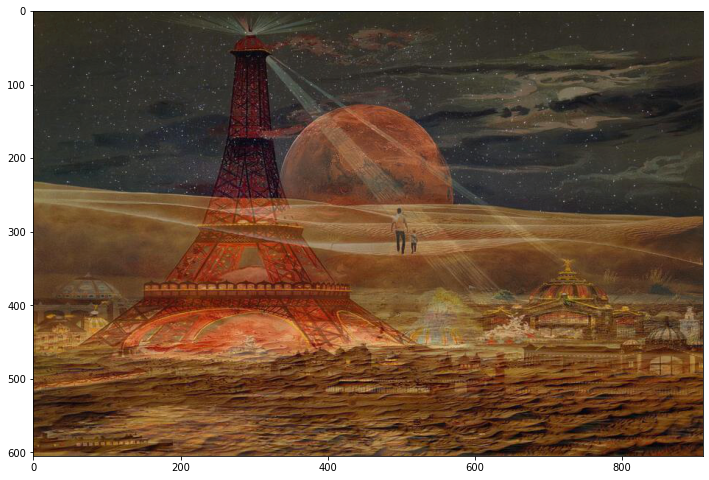

Step 0, loss 0.5804305076599121


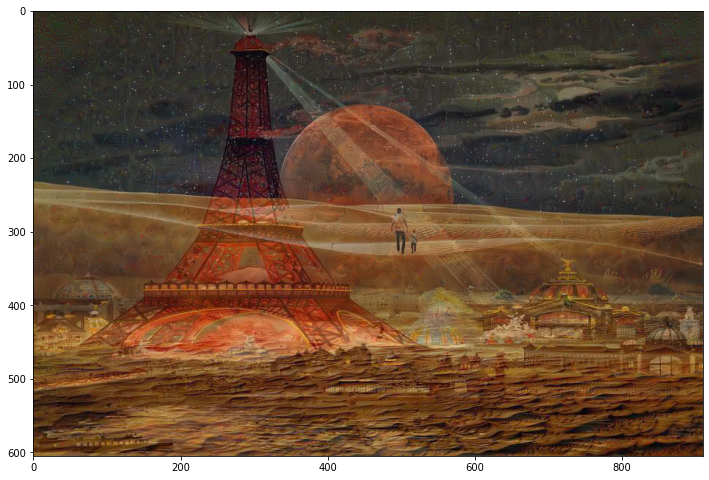

Step 100, loss 1.2858188152313232


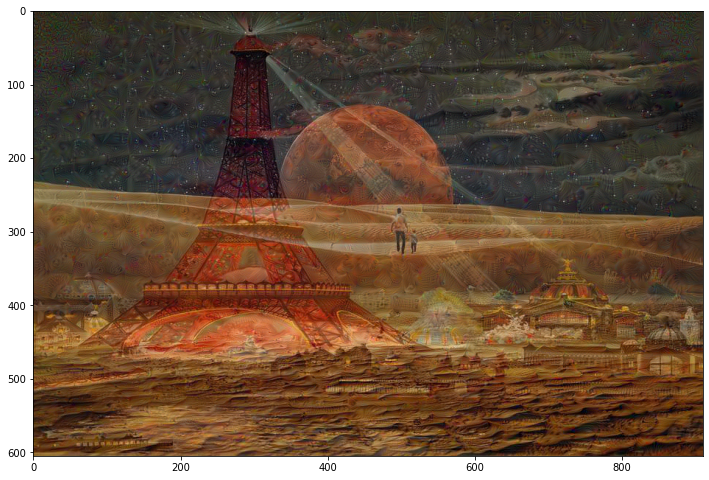

Step 200, loss 1.5013649463653564


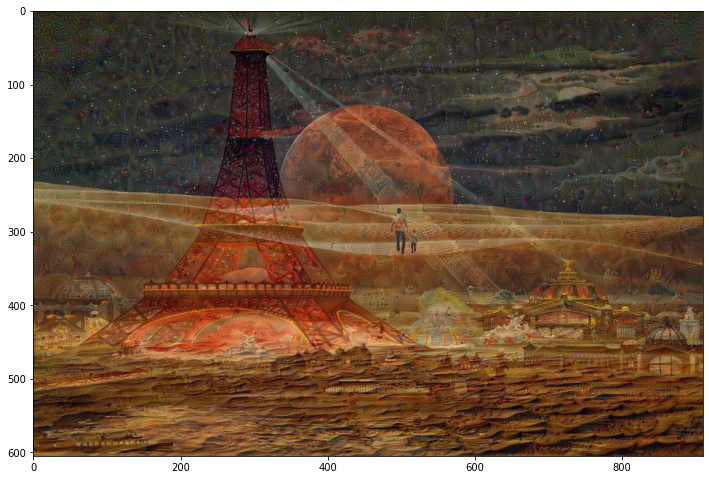

Step 300, loss 1.6391433477401733


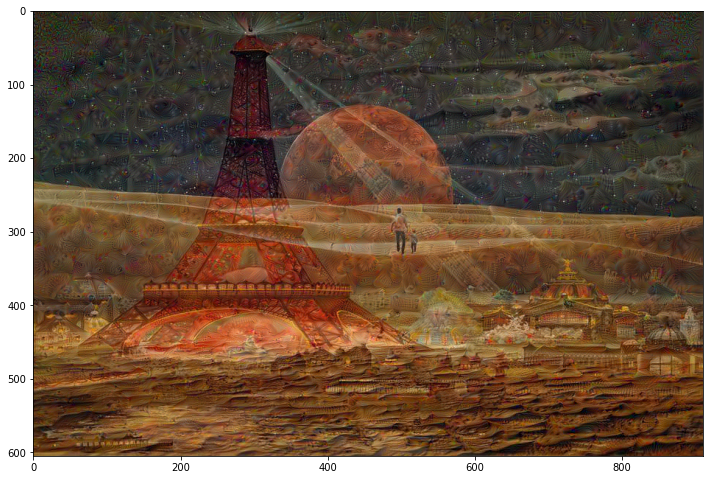

Step 400, loss 1.7377259731292725


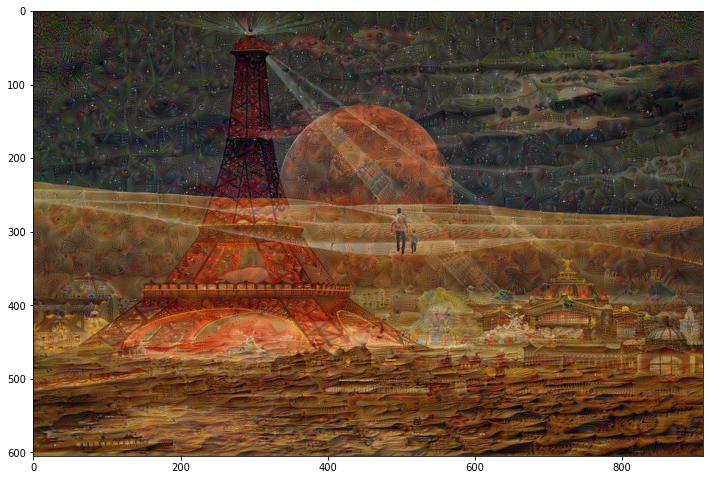

Step 500, loss 1.8178824186325073


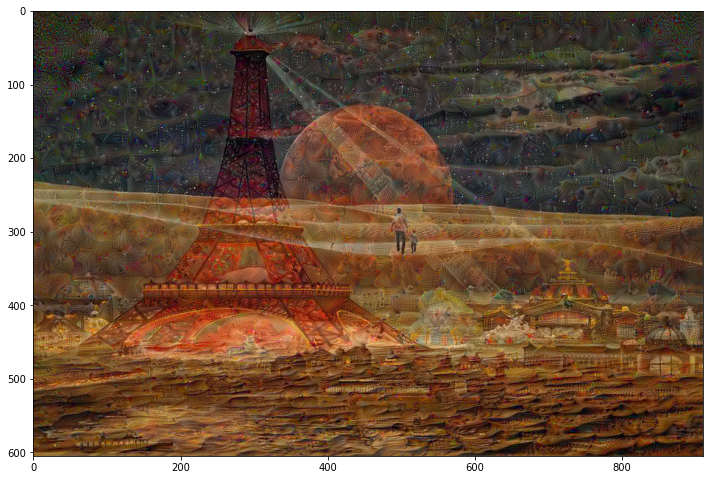

Step 600, loss 1.8850089311599731


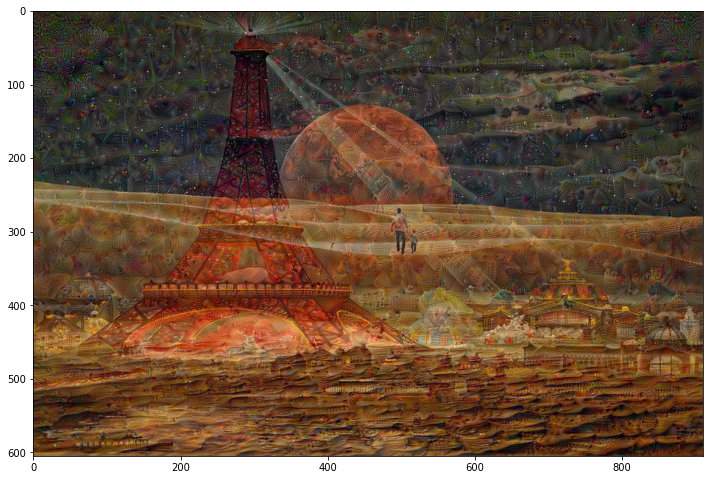

Step 700, loss 1.9437140226364136


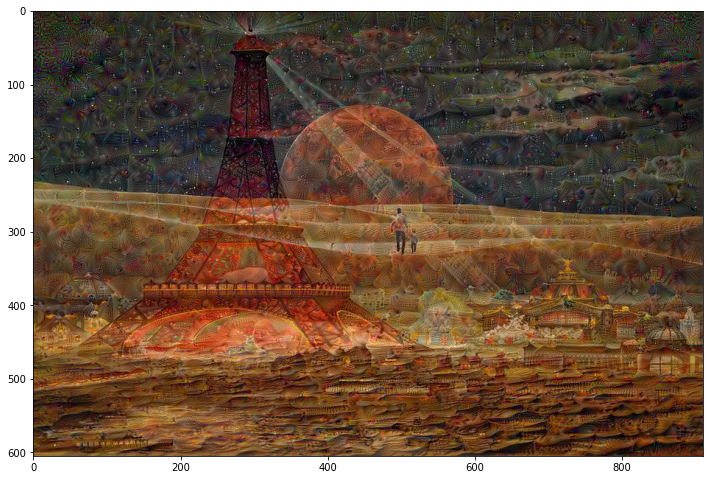

Step 800, loss 1.9948537349700928


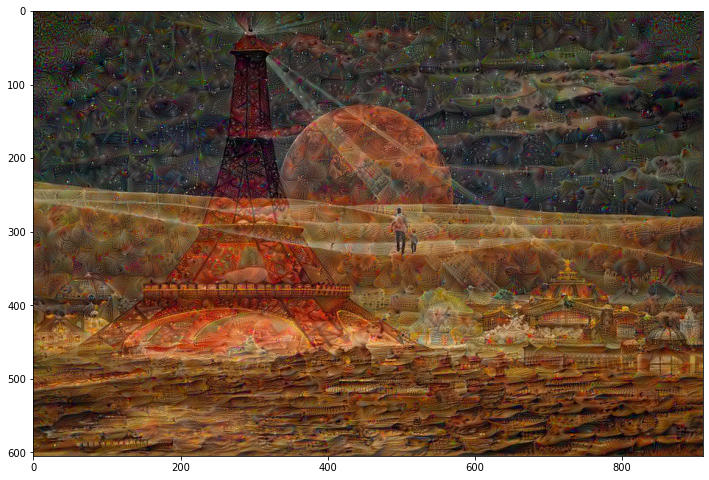

Step 900, loss 2.040349006652832


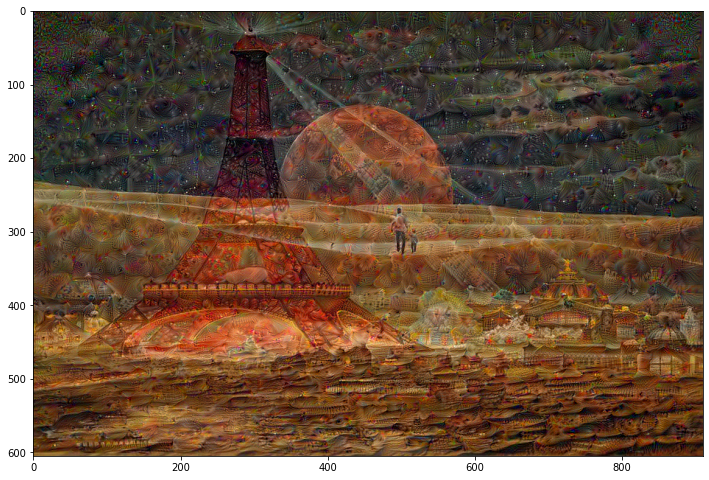

Step 1000, loss 2.0817301273345947


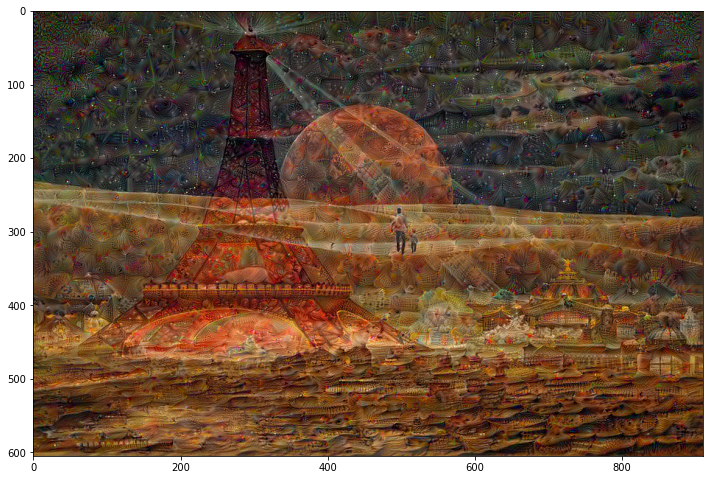

Step 1100, loss 2.119528293609619


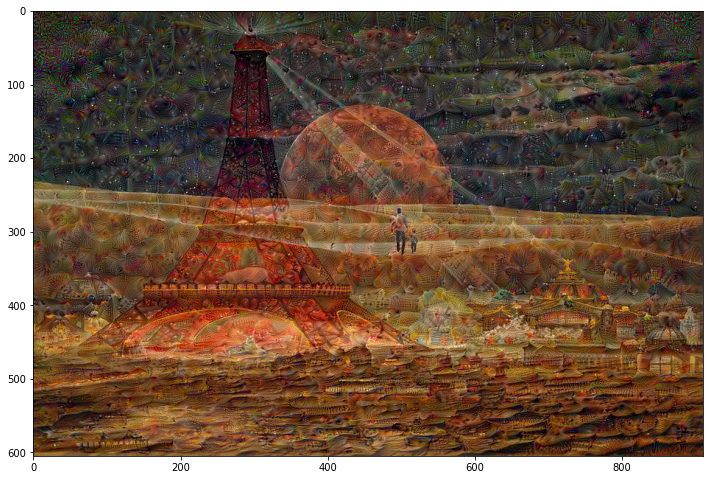

Step 1200, loss 2.15509295463562


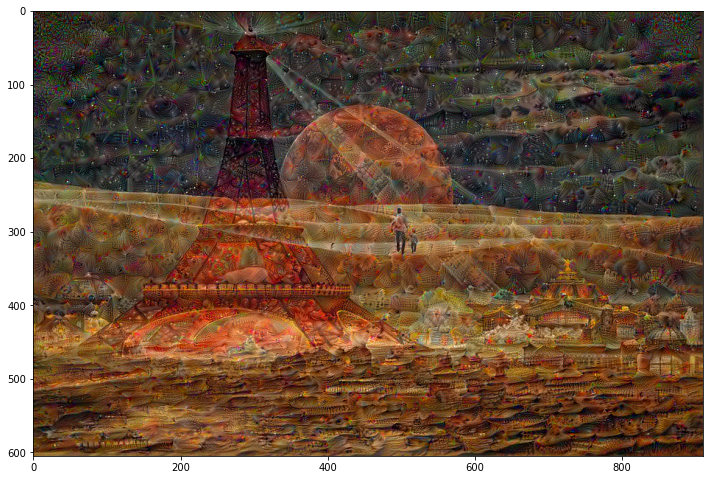

Step 1300, loss 2.1882424354553223


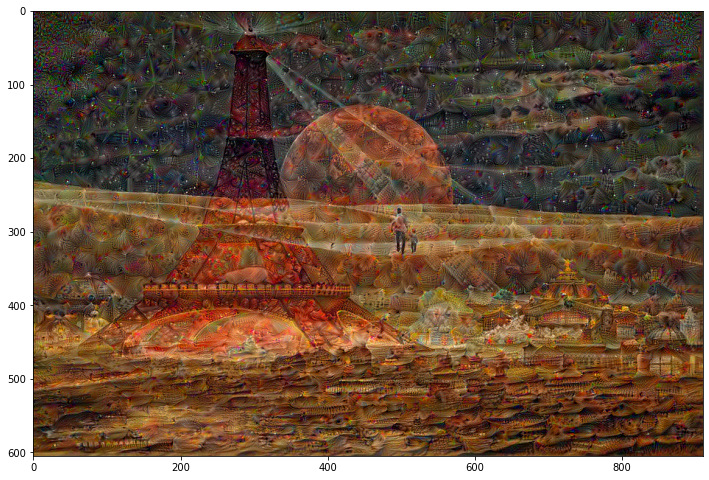

Step 1400, loss 2.2190794944763184


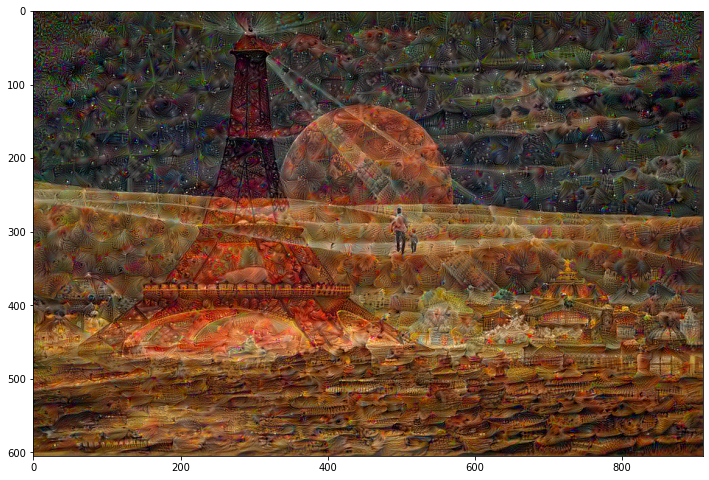

Step 1500, loss 2.248213768005371


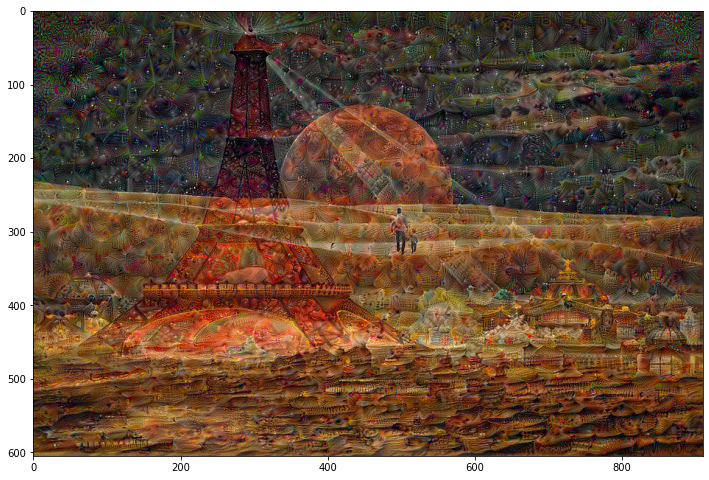

Step 1600, loss 2.275751829147339


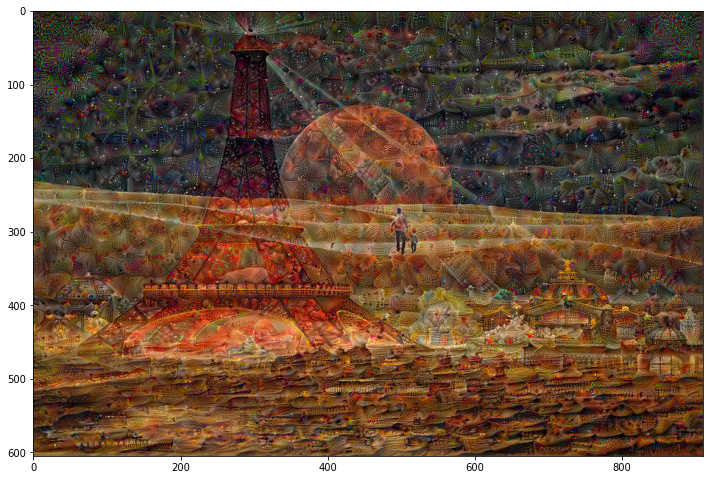

Step 1700, loss 2.301419734954834


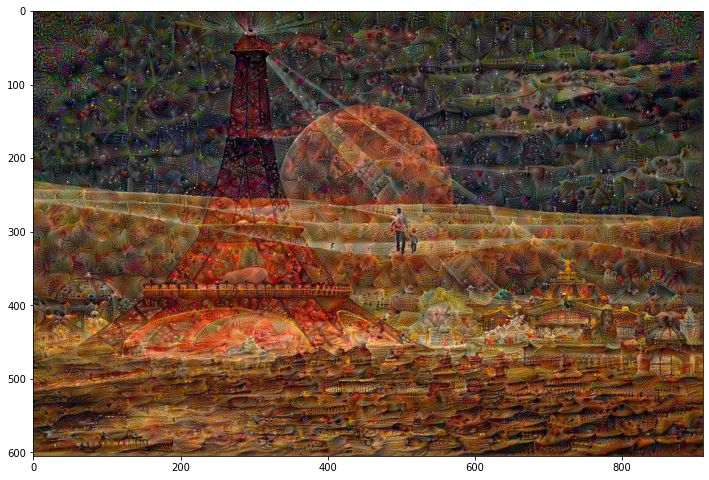

Step 1800, loss 2.325735092163086


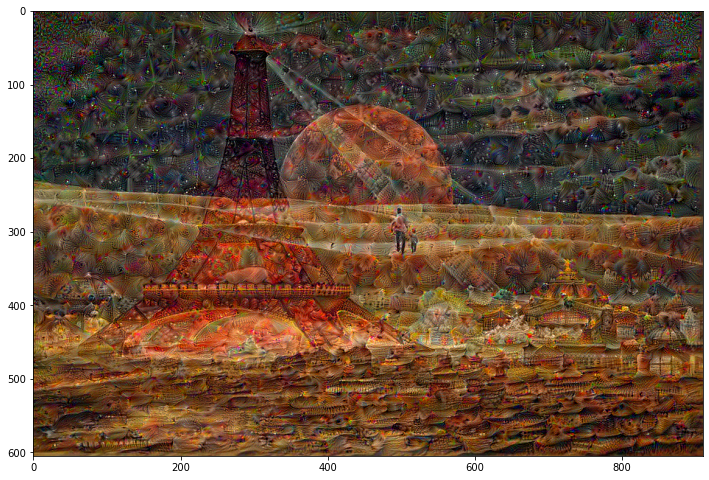

Step 1900, loss 2.3493542671203613


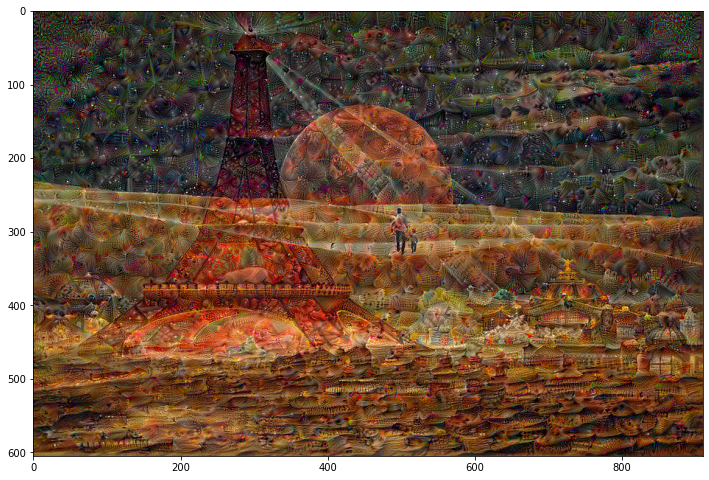

Step 2000, loss 2.371311664581299


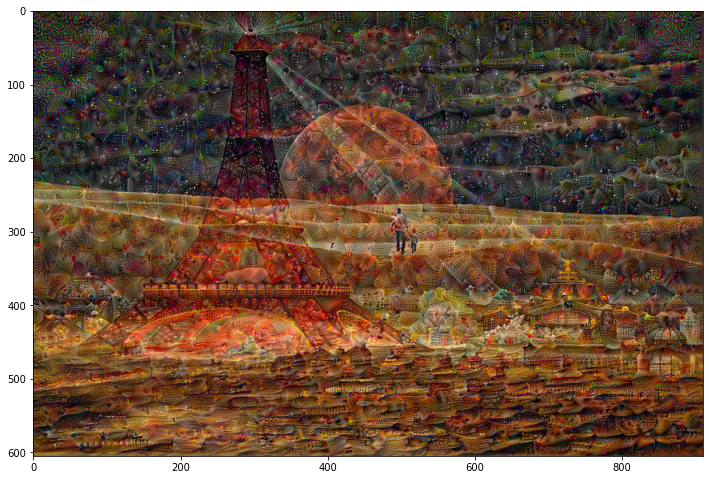

Step 2100, loss 2.392995595932007


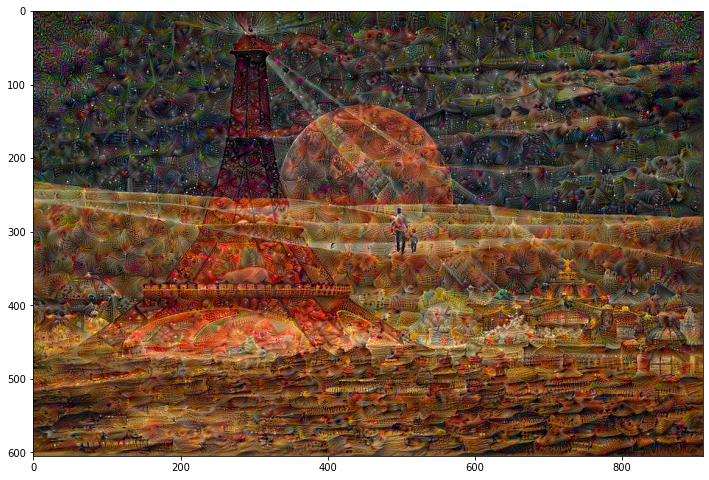

Step 2200, loss 2.4138858318328857


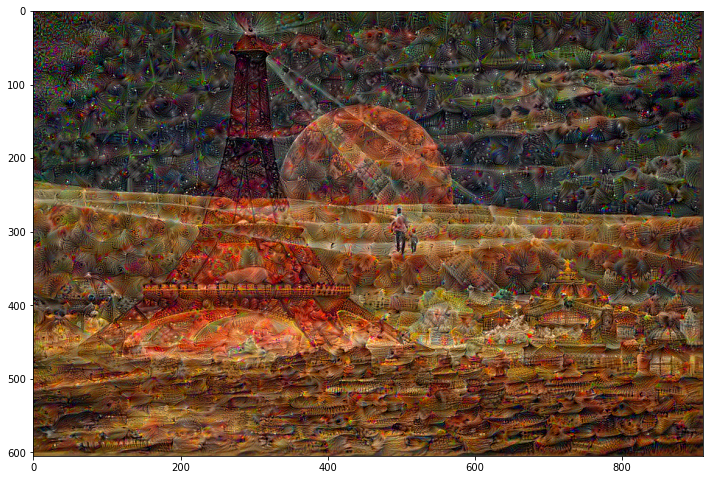

Step 2300, loss 2.43414306640625


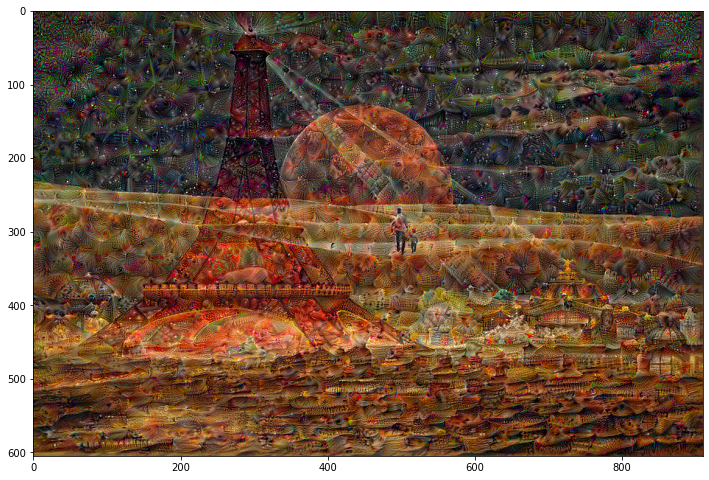

Step 2400, loss 2.453371047973633


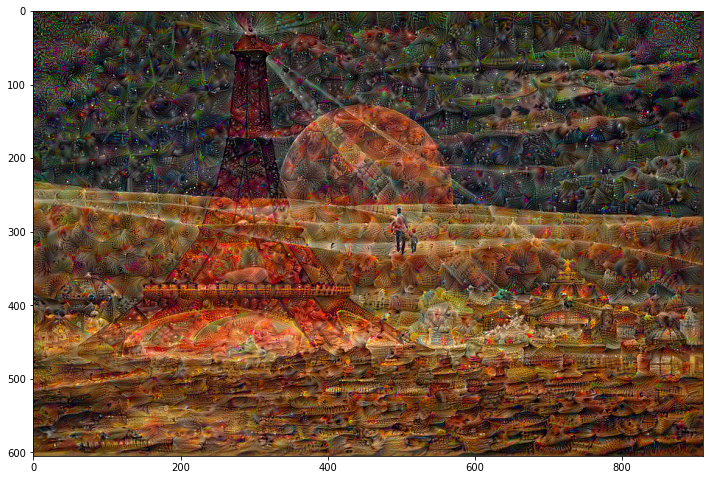

Step 2500, loss 2.47267484664917


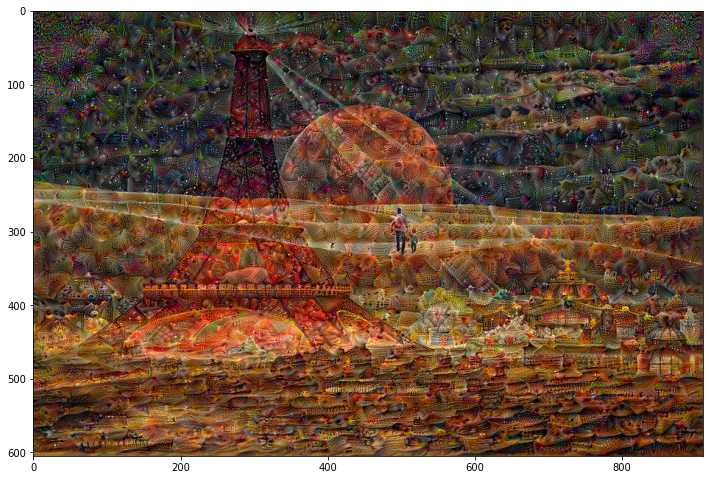

Step 2600, loss 2.4908194541931152


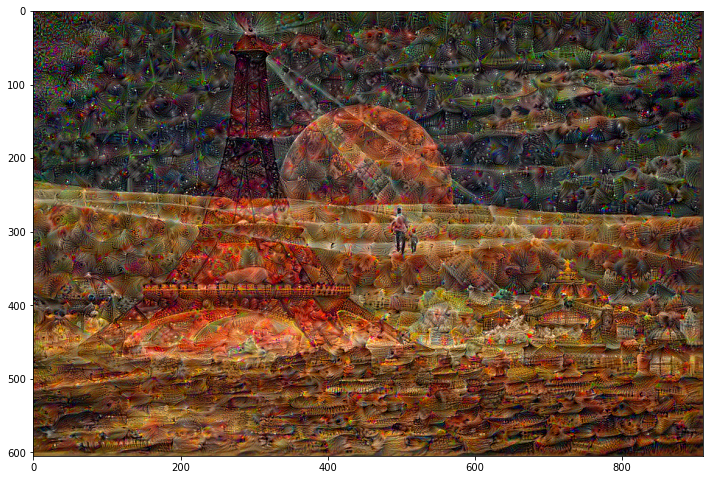

Step 2700, loss 2.5085320472717285


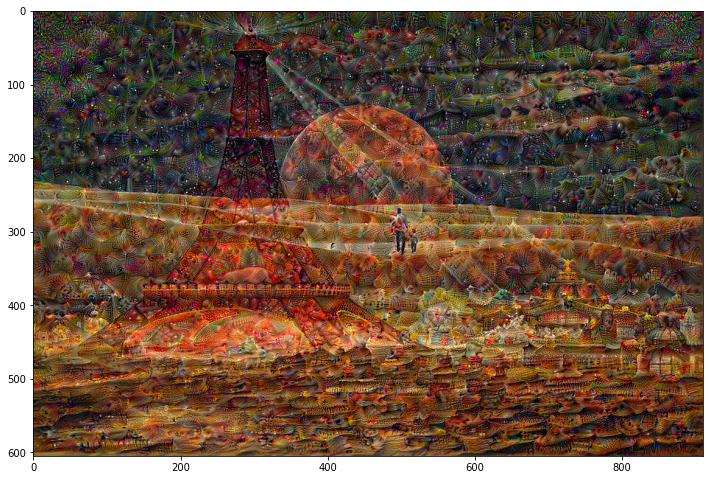

Step 2800, loss 2.5249881744384766


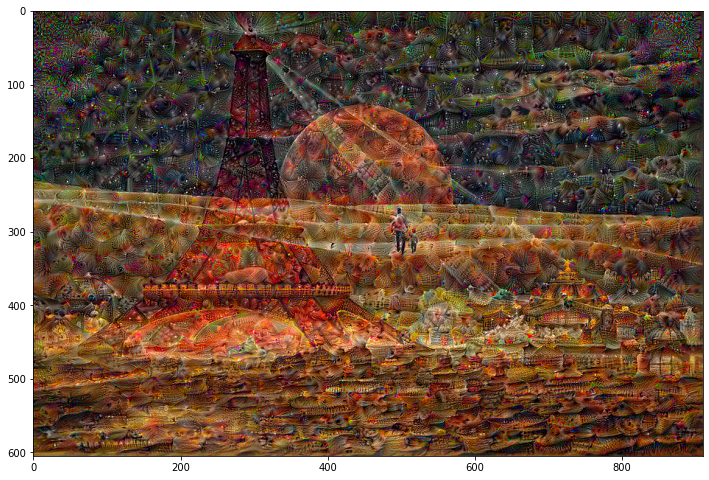

Step 2900, loss 2.541724681854248


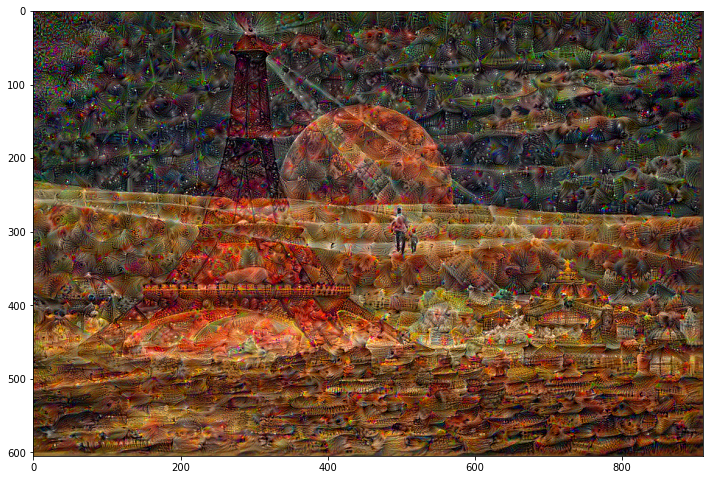

Step 3000, loss 2.5580294132232666


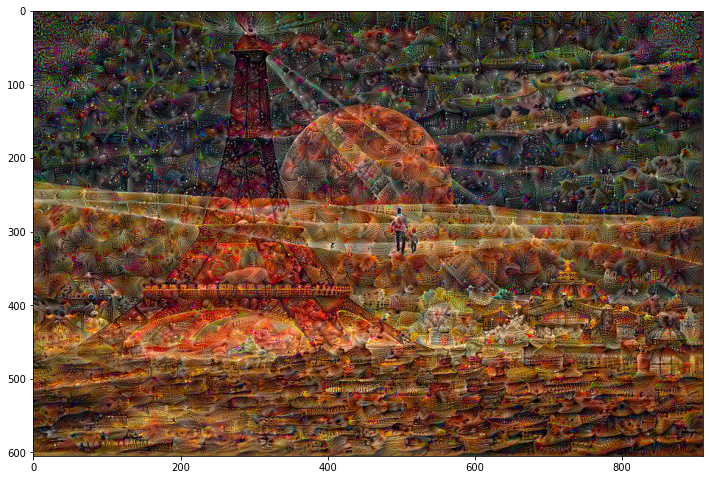

Step 3100, loss 2.573431968688965


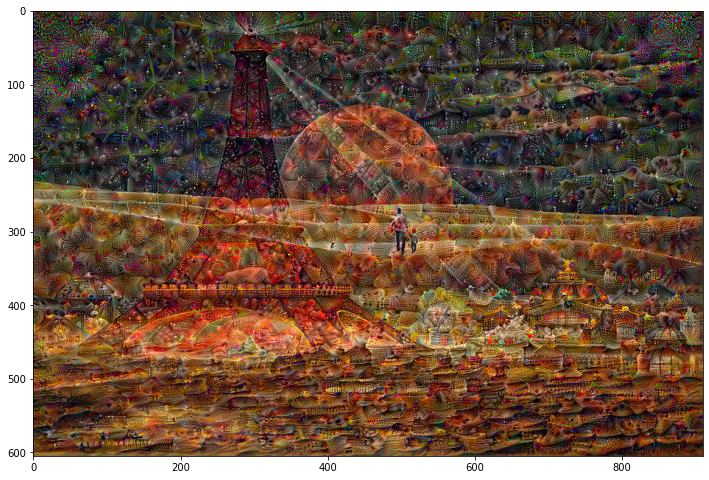

Step 3200, loss 2.5884313583374023


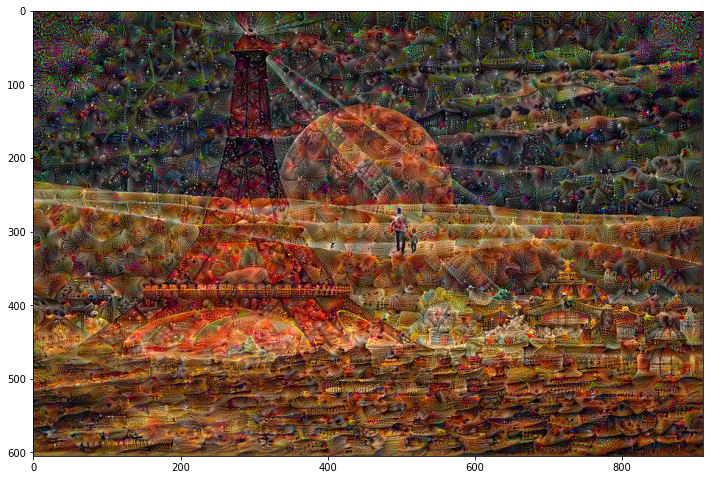

Step 3300, loss 2.603325366973877


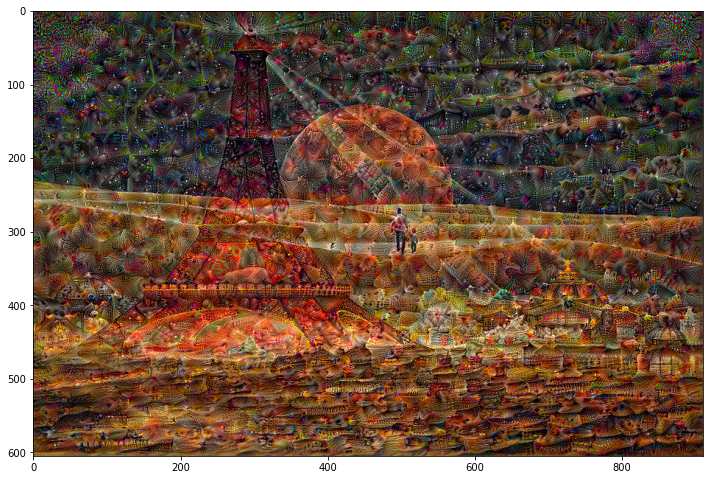

Step 3400, loss 2.6177196502685547


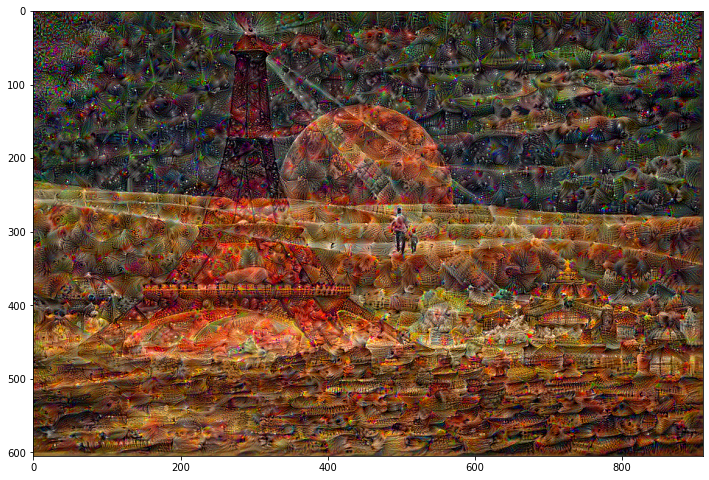

Step 3500, loss 2.6316335201263428


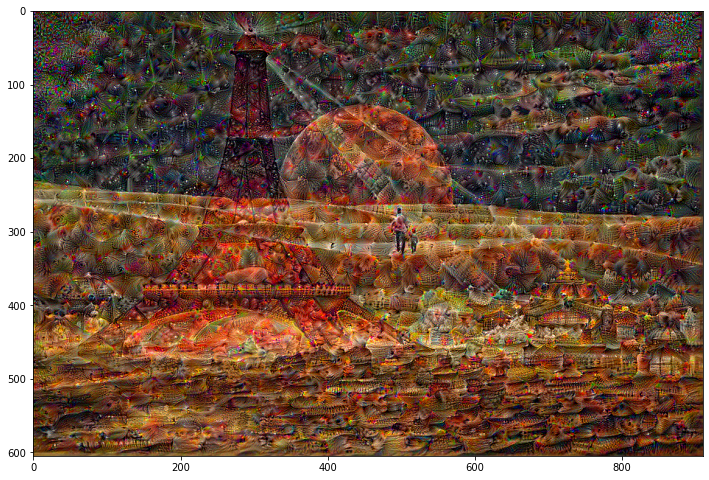

Step 3600, loss 2.645148992538452


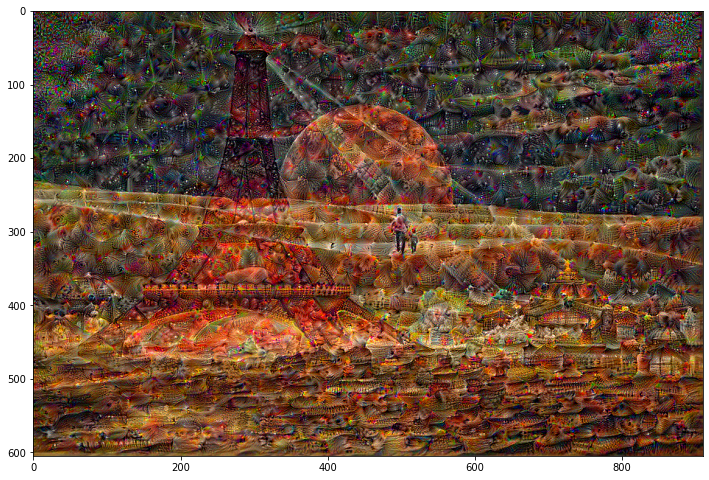

Step 3700, loss 2.6586995124816895


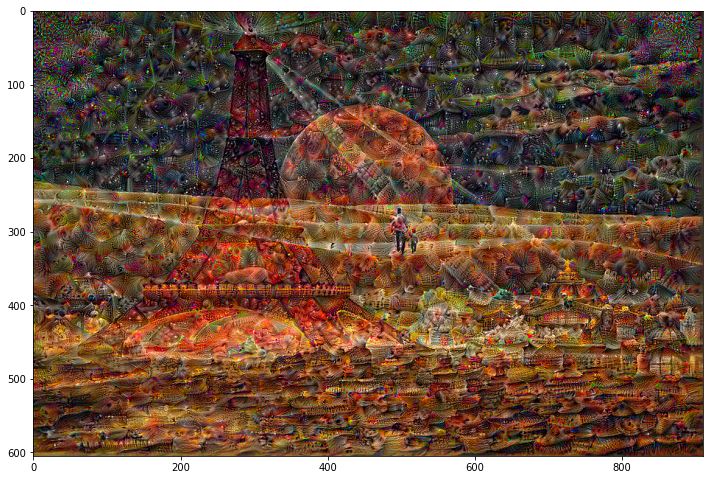

Step 3800, loss 2.6719439029693604


In [ ]:
# Let's Load the image again and convert it to Numpy array 
Sample_Image = np.array(tf.keras.preprocessing.image.load_img('img_0.jpg'))
dream_img = run_deep_dream_simple(model = deepdream_model, image = Sample_Image, steps = 4000, step_size = 0.001)